<a href="https://colab.research.google.com/github/Phillip-Gao/Flight-Forecast/blob/main/Flight-Forecast.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Introduction and Background

The plane has landed, your in-flight movie hits the credits, and you’re more than ready to stretch your legs. Your American Airlines plane taxis closer to the airport, when suddenly you jolt forward into the seat – the pilot has hit the breaks. Out the window, you see a Frontier Airlines plane hurtling past yours at over 160 miles per hour, just feet away from crashing into your plane. Merely seconds later, another German airliner speeds past, its wing nearly clipping the nose of your plane.

This is what happened at San Francisco International Airport on July 11th, 2023. You can watch a [simulation from the New York Times](https://int.nyt.com/data/videotape/finished/2023/08/1692363038/comp-2_6-1050w.mp4) by running the cell below.

In [ ]:
from IPython.display import Video
Video('https://int.nyt.com/data/videotape/finished/2023/08/1692363038/comp-2_6-1050w.mp4')

Worse? This was just one incident in about [300 “skin-to-skin” close-calls](https://www.nytimes.com/interactive/2023/08/21/business/airline-safety-close-calls.html) in the twelve months prior.

Why were those two planes cleared to leave the airport when a landing plane was taxiing dangerously close? There was clearly a lack of information by air traffic control about when exactly the American Airlines plane was going to cross the runway that the Frontier and German planes were set to depart from. But what if air traffic control could have known exactly when the Frontier plane would have arrived – before it even lifted off for San Francisco?
This leads us to our goal. In this project, we’ve sourced a [Flight Status dataset from Kaggle](https://www.kaggle.com/datasets/robikscube/flight-delay-dataset-20182022?select=Combined_Flights_2022.csv), with the goal of predicting flight delay times in minutes. Why would a few minutes gained or lost matter? Because if the Frontier airliner just a fraction of a minute later, it might not have been able to break fast enough to prevent a tragedy.


# Approach, Part I - Setup

The first step is the easiest - installing and importing all the necessary dependencies and packages. Since the Flight Status dataset is so large, we read it in (as `df`) from our Google Drive.

In [ ]:
!pip install pandasql
!pip install scikit-plot

In [ ]:
# Import necessary packages
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import pandasql as ps
import plotly.express as px
import plotly.graph_objects as go
import gc

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import roc_curve, auc
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import GridSearchCV

In [ ]:
# Mount drive
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Read the csv file for 2022 flight data and airline info, save into to dataframes called "df_2022" and "df_url_airlines"
df_url_2022 = '/content/drive/Shareddrives/CIS 5450 Project (VPN)/Combined_Flights_2022.csv'
df_url_airlines = '/content/drive/Shareddrives/CIS 5450 Project (VPN)/Airlines.csv'

# We join with additional data about airlines
df_2022 = pd.read_csv(df_url_2022)
gc.collect()
df_airlines = pd.read_csv(df_url_airlines)
gc.collect()
df_airlines.rename(columns={'Description': 'Airline'}, inplace = True)

In [ ]:
# Merge into singular dataframe df
df = pd.merge(df_2022, df_airlines, on = 'Airline', how = 'inner')
gc.collect()

0

# Approach, Part II - Data Cleaning & Feature Engineering

## Understanding our data

First, let's look at the first few rows of our data, and also examine a summary of information about our dataset.

In [ ]:
# Check out first 5 rows
df.head(5)

,FlightDate,Airline,Origin,Dest,Cancelled,Diverted,CRSDepTime,DepTime,DepDelayMinutes,DepDelay,...,WheelsOn,TaxiIn,CRSArrTime,ArrDelay,ArrDel15,ArrivalDelayGroups,ArrTimeBlk,DistanceGroup,DivAirportLandings,Code
0,2022-04-04,"Commutair Aka Champlain Enterprises, Inc.",GJT,DEN,False,False,1133,1123.0,0.0,-10.0,...,1220.0,8.0,1245,-17.0,0.0,-2.0,1200-1259,1,0,C5
1,2022-04-04,"Commutair Aka Champlain Enterprises, Inc.",HRL,IAH,False,False,732,728.0,0.0,-4.0,...,839.0,9.0,849,-1.0,0.0,-1.0,0800-0859,2,0,C5
2,2022-04-04,"Commutair Aka Champlain Enterprises, Inc.",DRO,DEN,False,False,1529,1514.0,0.0,-15.0,...,1622.0,14.0,1639,-3.0,0.0,-1.0,1600-1659,2,0,C5
3,2022-04-04,"Commutair Aka Champlain Enterprises, Inc.",IAH,GPT,False,False,1435,1430.0,0.0,-5.0,...,1543.0,4.0,1605,-18.0,0.0,-2.0,1600-1659,2,0,C5
4,2022-04-04,"Commutair Aka Champlain Enterprises, Inc.",DRO,DEN,False,False,1135,1135.0,0.0,0.0,...,1243.0,8.0,1245,6.0,0.0,0.0,1200-1259,2,0,C5


In [ ]:
# Check out column types
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4078318 entries, 0 to 4078317
Data columns (total 62 columns):
 #   Column                                   Dtype  
---  ------                                   -----  
 0   FlightDate                               object 
 1   Airline                                  object 
 2   Origin                                   object 
 3   Dest                                     object 
 4   Cancelled                                bool   
 5   Diverted                                 bool   
 6   CRSDepTime                               int64  
 7   DepTime                                  float64
 8   DepDelayMinutes                          float64
 9   DepDelay                                 float64
 10  ArrTime                                  float64
 11  ArrDelayMinutes                          float64
 12  AirTime                                  float64
 13  CRSElapsedTime                           float64
 14  ActualElapsedTime 

# Approach, Part II - Exploratory Data Analysis

We want to create an accurate analysis and summary our dataset. We'll start out by dropping any null rows in the dataset, shuffling, then taking the first 1.5 million rows, then visualizing the different columns as histograms to observe the distribution of data values for each attribute.

Note that due to the shuffling, re-running the notebook provides different results than what is in the slides

In [ ]:
# Drop null rows
df.dropna(inplace = True)

In [ ]:
# Shuffle and take the first 1,500,000 rows
df = df.sample(frac=1).head(1500000).reset_index(drop=True)
gc.collect()

0

### Histogram of Numerical Columns

Created histogram plots of every feature containing numerical data (20 plots)

Findings:


*   Arrival delay and departure delay is highly centralized
*   Relevant features like elapsed time and airtime have positively skewed distribution.



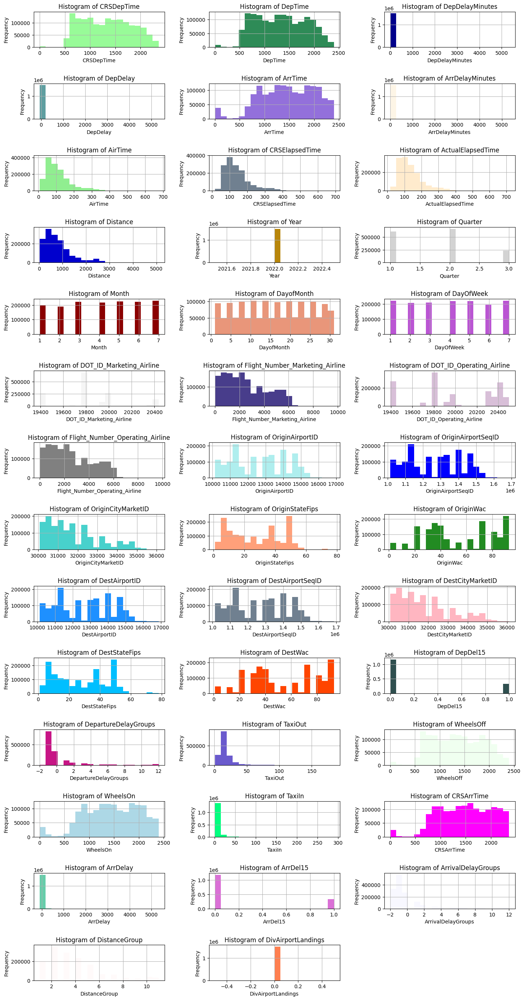

In [ ]:
# Select numerical columns to plot
numerical_cols = df.select_dtypes(include=['int64', 'float64']).columns

# Calculate the number of rows needed for three columns
n_rows = (len(numerical_cols) + 2) // 3

# Create a figure with multiple subplots
fig, axes = plt.subplots(nrows=n_rows, ncols=3, figsize=(15, n_rows * 2))
fig.tight_layout(pad=5.0)  # Adjust padding

# Generate a list of random colors
colors = np.random.choice(list(mcolors.CSS4_COLORS.values()), len(numerical_cols), replace=False)

# Flatten the axes array and plot each column with a random color
for ax, col, color in zip(axes.flat, numerical_cols, colors):
    df[col].hist(bins=20, ax=ax, color=color)
    ax.set_title(f'Histogram of {col}')
    ax.set_xlabel(col)
    ax.set_ylabel('Frequency')

# Hide any unused axes if the number of numerical columns isn't a multiple of three
for i in range(len(numerical_cols), n_rows * 3):
    fig.delaxes(axes.flatten()[i])

# Show the plot
plt.show()

### Pairplot of four features

We also want to use plotly to create a pair-plot, which lets us understand the relationships between several variables that we're especially interested in.

Findings:


*   As expected, arrival delay/departure delay and arrival time/distance are positively correlated
*   Arrival time mostly independent of distance and airtime (longer flights aren’t delayed for longer)


In [ ]:
# Define the subset of the DataFrame to be plotted
subset_df = df[['DepDelay', 'ArrDelay', 'AirTime', 'Distance']]

# Create the scatter matrix (pair plot) using Plotly Express
fig = px.scatter_matrix(subset_df,
                        dimensions=['DepDelay', 'ArrDelay', 'AirTime', 'Distance'],
                        title='Pair Plot of Departure Delay, Arrival Delay, Air Time, and Distance',
                        labels={col: col.replace('_', ' ') for col in subset_df.columns},
                        height=900, width=900)

# Show the plot
fig.show()

### Boxplot of four features

Created boxplot of departure delay, arrival delay, air time, and distance.

Findings:


*   Arrival delay/departure delay are highly concentrated while airtime/distance are not (as shown by the small interquartile range)
*  There exists a significant amount of outliers in terms of arrival delay/departure delay.



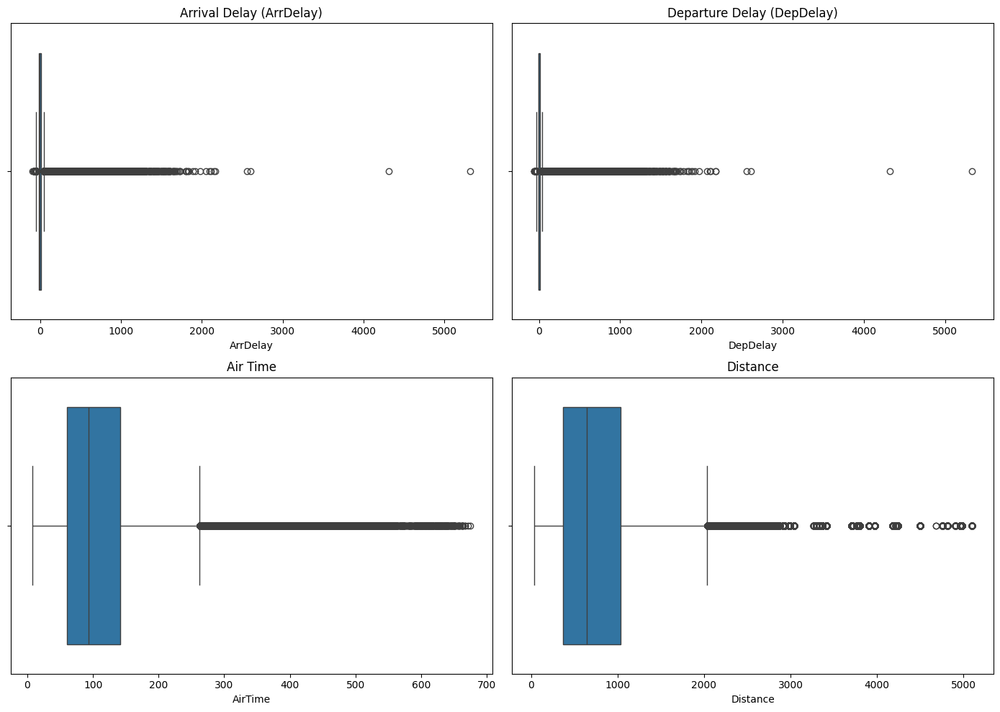

In [ ]:
# Assuming 'df' is your DataFrame
fig, axes = plt.subplots(2, 2, figsize=(14, 10))

sns.boxplot(x=df['ArrDelay'], ax=axes[0, 0])
axes[0, 0].set_title('Arrival Delay (ArrDelay)')

sns.boxplot(x=df['DepDelay'], ax=axes[0, 1])
axes[0, 1].set_title('Departure Delay (DepDelay)')

sns.boxplot(x=df['AirTime'], ax=axes[1, 0])
axes[1, 0].set_title('Air Time')

sns.boxplot(x=df['Distance'], ax=axes[1, 1])
axes[1, 1].set_title('Distance')

plt.tight_layout()
plt.show()

## Thinking about the data

What are the potential issues with the data?
1.  Missing data - canceled or diverted flights may not have a Departure Time `DepTime` or Arrival Time `ArrTime`, for example.
2.  Categorical data - the models we want to use may require numerical input, but our dataset includes numerous categorical variables like `Airline`, `Origin`, `Dest`, etc.
3.  Outliers - As shown in the pairplots, there exists some datapoints that are evidently outliers (for example, one of the flights has an arrival delay of 7,000 minutes, which is clearly an anomaly).
4.  Redundant Data - In some of our columns, we see that there is only one unique data value. This would not help our models predict the 'ArrDelay' correctly.
5.  Too many data points - The original dataset contained approximately 4 million rows of data. This would be too much data to train our models on.

And what are solutions to clean the data?
1.   We dropped rows will null values. We could also case on flights that were not cancelled or diverted.
2.   Depending on whether we have nominal data without ordering or ordinal data, we will use a OneHotEncoder or an OrdinalEncoder (as we did in HW4). We can also manually convert columns to appropriate data types (map strings to ints)
3.  For every column containing numerical data, we would first calculate the 1st percentile and the 99th percentile. Then, we use these values to calculate the interquartile range, and then establish the lower and upper bound. Finally, we remove the values that fall outside of these bounds, which are the outliers.
4.  To address the issue of redundant data, we can simply remove the columns that contain only a singular data type.
5.  We first randomly selected a million rows from the dataframe. Then we parsed by flights that came out of or went to a city in PA. Finally, we conditioned that each flight we consider must not be cancelled or diverted. We could then scale the data afterward using Standard Scaler.

In [ ]:
# Drop ArrDel15 and DepDel15 columns
print(df['ArrDel15'].nunique())
print(df['DepDel15'].nunique())

df = df.drop(columns= ['ArrDel15', 'DepDel15'])
gc.collect()

2
2


3793

In [ ]:
# Define the columns to check for outliers
columns = df.select_dtypes(exclude=['object', 'bool']).columns

# Initialize a set to store outlier indices
outliers = set()

for col in columns:
    # Calculate Q1 (1th percentile) and Q3 (99th percentile)
    Q1 = df[col].quantile(0.01)
    Q3 = df[col].quantile(0.99)
    IQR = Q3 - Q1

    # Calculate the outlier cutoffs
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    # Determine which rows in the DataFrame have outliers
    outlier_rows = df[(df[col] < lower_bound) | (df[col] > upper_bound)]

    # Store the indices of the outliers
    outliers.update(outlier_rows.index)

# Ensure all indices are currently in the DataFrame before attempting to drop
outliers = [idx for idx in outliers if idx in df.index]

# Remove outliers from dataset
df = df.drop(index = outliers)
gc.collect()

18

This block of code filters the dataset to include only those flights where either the origin or destination is in Pennsylvania and ensures that these flights have not been cancelled or diverted. This process focuses our data to focus on flights specifically relevant to Pennsylvania.

In [ ]:
# Filter by flights whose origin or destination is in Pennsylvania
# Also filter by non-cancelled and non-diverted flights

query = '''

SELECT *
FROM df
WHERE
  (OriginState = 'PA' OR DestState = 'PA')
  AND NOT Cancelled
  AND NOT Diverted

'''

df = ps.sqldf(query, locals())
gc.collect()

13

In [ ]:
#Converting to int so that we can process

for col in df.columns:
  if df[col].dtype=='object':
    lis = df[col].unique()
    dic = {}
    for index, element in enumerate(lis):
      dic[element] = index
    df[col] = df[col].map(lambda x: dic[x])
df.head()

,FlightDate,Airline,Origin,Dest,Cancelled,Diverted,CRSDepTime,DepTime,DepDelayMinutes,DepDelay,...,WheelsOff,WheelsOn,TaxiIn,CRSArrTime,ArrDelay,ArrivalDelayGroups,ArrTimeBlk,DistanceGroup,DivAirportLandings,Code
88,0,0,0,0,False,False,1405,1400.0,0.0,-5.0,...,1438.0,1608.0,6.0,1614,0.0,0.0,0,3,0,0
97,1,1,1,1,False,False,1700,1651.0,0.0,-9.0,...,1702.0,1725.0,9.0,1742,-8.0,-1.0,1,2,0,1
98,2,2,0,2,False,False,1345,1344.0,0.0,-1.0,...,1408.0,1457.0,4.0,1510,-9.0,-1.0,2,2,0,2
103,3,1,2,3,False,False,910,858.0,0.0,-12.0,...,932.0,1027.0,6.0,1047,-14.0,-1.0,3,2,0,1
104,1,0,3,4,False,False,905,855.0,0.0,-10.0,...,908.0,946.0,3.0,1018,-29.0,-2.0,3,1,0,0


In [ ]:
# Select columns with object and bool
categorical_cols = df.select_dtypes(include=['bool']).columns.tolist()

# Applying OneHotEncoder
encoder = OneHotEncoder(sparse_output = False, drop='first')
encoded_features = encoder.fit_transform(df[categorical_cols])

# Creating a DataFrame with the encoded features
encoded_df = pd.DataFrame(encoded_features, columns=encoder.get_feature_names_out(categorical_cols))

# Concatenating the original DataFrame with the new one (excluding original categorical columns)
df = pd.concat([df.drop(categorical_cols, axis=1), encoded_df], axis=1)
df.dropna(inplace=True)

In [ ]:
df.shape

(70836, 58)

In [ ]:
df.head()

,FlightDate,Airline,Origin,Dest,CRSDepTime,DepTime,DepDelayMinutes,DepDelay,ArrTime,ArrDelayMinutes,...,WheelsOff,WheelsOn,TaxiIn,CRSArrTime,ArrDelay,ArrivalDelayGroups,ArrTimeBlk,DistanceGroup,DivAirportLandings,Code
88,0.0,0.0,0.0,0.0,1405.0,1400.0,0.0,-5.0,1614.0,0.0,...,1438.0,1608.0,6.0,1614.0,0.0,0.0,0.0,3.0,0.0,0.0
97,1.0,1.0,1.0,1.0,1700.0,1651.0,0.0,-9.0,1734.0,0.0,...,1702.0,1725.0,9.0,1742.0,-8.0,-1.0,1.0,2.0,0.0,1.0
98,2.0,2.0,0.0,2.0,1345.0,1344.0,0.0,-1.0,1501.0,0.0,...,1408.0,1457.0,4.0,1510.0,-9.0,-1.0,2.0,2.0,0.0,2.0
103,3.0,1.0,2.0,3.0,910.0,858.0,0.0,-12.0,1033.0,0.0,...,932.0,1027.0,6.0,1047.0,-14.0,-1.0,3.0,2.0,0.0,1.0
104,1.0,0.0,3.0,4.0,905.0,855.0,0.0,-10.0,949.0,0.0,...,908.0,946.0,3.0,1018.0,-29.0,-2.0,3.0,1.0,0.0,0.0


## Feature Importance: finding correlations with the output

The objective is to identify which features are most strongly correlated with arrival delays, potentially offering insights into which factors significantly influence flight delays.

In [ ]:
# Calculate the correlation matrix
correlation_matrix = df.corr()

# Extract the correlations of all features with 'ArrDelay'
arrdelay_correlations = correlation_matrix['ArrDelay']

# Drop the self-correlation of 'ArrDelay' with itself
arrdelay_correlations = arrdelay_correlations.drop('ArrDelay', axis=0)

# Drop the high correlation of 'ArrDelayMinutes'
arrdelay_correlations = arrdelay_correlations.drop('ArrDelayMinutes', axis=0)

# Display the correlations
print(arrdelay_correlations)

# To find the feature(s) with the highest absolute correlation
most_correlated_feature = arrdelay_correlations.abs().idxmax()
highest_correlation_value = arrdelay_correlations[most_correlated_feature]

FlightDate                                 0.008114
Airline                                    0.015907
Origin                                     0.007110
Dest                                      -0.009825
CRSDepTime                                 0.110826
DepTime                                    0.186422
DepDelayMinutes                            0.942676
DepDelay                                   0.946852
ArrTime                                    0.063018
AirTime                                    0.006504
CRSElapsedTime                            -0.024148
ActualElapsedTime                          0.054357
Distance                                  -0.008930
Year                                            NaN
Quarter                                    0.016962
Month                                      0.024676
DayofMonth                                -0.019552
DayOfWeek                                  0.057357
Marketing_Airline_Network                  0.044841
Operated_or_

In [ ]:
arrdelay_correlations.reset_index().dropna().sort_values(by='ArrDelay')

,index,ArrDelay
22,Flight_Number_Marketing_Airline,-0.037730
27,Flight_Number_Operating_Airline,-0.037586
33,OriginStateFips,-0.035662
43,DestWac,-0.025903
10,CRSElapsedTime,-0.024148
16,DayofMonth,-0.019552
45,DepTimeBlk,-0.016600
29,OriginAirportSeqID,-0.011231
28,OriginAirportID,-0.011231
3,Dest,-0.009825


# Linear Regression

### Justification

1.  **Simplicity and Interpretability:** Linear regression is straightforward to implement and requires fewer computational resources compared to more complex models like random forests or neural networks. Linear regression provides clear interpretability, as each coefficient in the model directly represents the expected change in the dependent variable for a one-unit change in an independent variable.
2.   **Relationship Modeling:** If the relationship between the dependent variable and the independent variables is approximately linear, linear regression can be an effective tool.
3.   **Quantifying Relationships:** Linear regression not only predicts outcomes but also quantifies the relationships between variables, which is useful for understanding which factors are most important to predicting arrival delays.


### Limitations and Potential Biases
1.   **Assumption of Linearity:** Linear regression assumes that there is a linear relationship between the independent and dependent variables. If this assumption does not hold, the model’s predictions can be inaccurate. In reality, the relationship between variables like departure delay and arrival delay might be affected by nonlinear factors.
2.   **Multicollinearity:** If the dataframe contains highly correlated predictors, it can cause multicollinearity problems, where it becomes difficult to distinguish the individual effects of correlated variables on the dependent variable. This can lead to unreliable estimates of regression coefficients.
3.   **Homoscedasticity:** The model assumes homoscedasticity, meaning the residuals (differences between observed and predicted values) should have constant variance across all levels of the independent variables. Heteroscedasticity (non-constant variance) can lead to inefficiencies and an underestimate of the standard errors.

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.metrics import mean_squared_error
import math

# Select top 10 features from df (without redundancy)
columns = ['ArrivalDelayGroups', 'DepDelay', 'TaxiOut', 'DepTime', 'WheelsOff', 'TaxiIn', 'CRSDepTime', 'CRSArrTime', 'Marketing_Airline_Network', 'IATA_Code_Marketing_Airline']

# Selecting features and target variable
X = df[columns]
y = df['ArrDelay']

# Handling missing values
X.fillna(X.mean(), inplace=True)
y.fillna(y.mean(), inplace=True)

# Splitting the dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Scaling the features
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

<ipython-input-23-720298fbe060>:16: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
# Instantiate and Fit PCA
pca = PCA()
X2 = pca.fit(X_train)

# Save the explained variance ratios into variable called "explained_variance_ratios"
explained_variance_ratios = pca.explained_variance_ratio_

# Save the cumulative explained variance ratios into variable called "cum_evr"
cum_evr = np.cumsum(explained_variance_ratios)

Text(0.5, 1.0, 'Cumulative Explained Variance vs. Number of PCA Components')

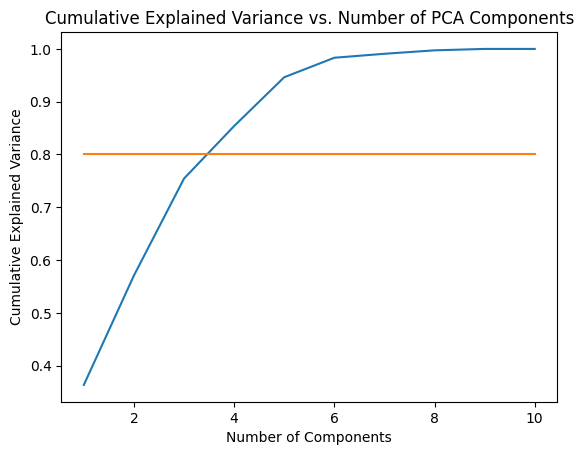

In [ ]:
# Find optimal num components to use (n) by plotting explained variance ratio

x_ticks = np.arange(len(cum_evr)) + 1

plt.plot(size = [8, 6])
sns.lineplot(x = x_ticks, y = cum_evr)
sns.lineplot(x = x_ticks, y = 0.8 * np.ones(len(cum_evr)))
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.title('Cumulative Explained Variance vs. Number of PCA Components')

In [ ]:
# 1. Refit and transform on training with parameter n (as deduced from the last step)
n = 4
pca = PCA(n_components = n)
X_train_pca = pca.fit_transform(X_train)

# 2. Transform on Testing Set and store it as `X_test_pca`
X_test_pca = pca.transform(X_test)

In [ ]:
# Creating and training the model
lr_model = LinearRegression()
lr_model.fit(X_train, y_train)

# Predicting on the test set
y_pred = lr_model.predict(X_test)

# Calculating the Mean Squared Error
sd = math.sqrt(mean_squared_error(y_test, y_pred))
print("RMS Error:", sd)

def custom_accuracy(y_true, y_pred, threshold=5):
    return np.mean(np.abs(y_true - y_pred) <= threshold)

print("Accuracy:", custom_accuracy(y_test,y_pred,5))

RMS Error: 7.6740465806061415
Accuracy: 0.6046725014116319


## Model Analysis


---



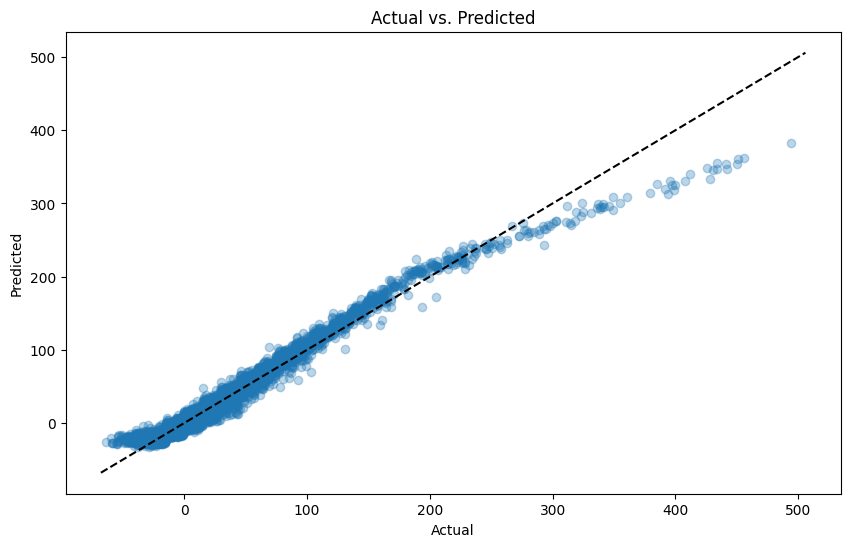

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Plot Actual vs Predicted (EDA #1)
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, alpha=0.3)
plt.plot([y.min(), y.max()], [y.min(), y.max()], 'k--')
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Actual vs. Predicted')
plt.show()

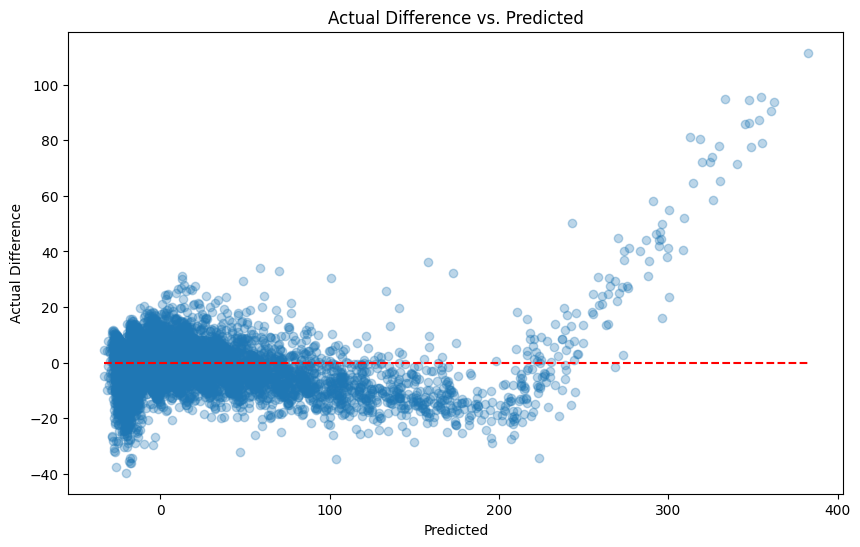

In [ ]:
# Plot Actual Difference vs. Predicted Difference (EDA #2)

difference = y_test - y_pred
plt.figure(figsize=(10, 6))
plt.scatter(y_pred, difference, alpha=0.3)
plt.hlines(y=0, xmin = y_pred.min(), xmax = y_pred.max(), colors = 'red', linestyles = '--')
plt.xlabel('Predicted')
plt.ylabel('Actual Difference')
plt.title('Actual Difference vs. Predicted')
plt.show()

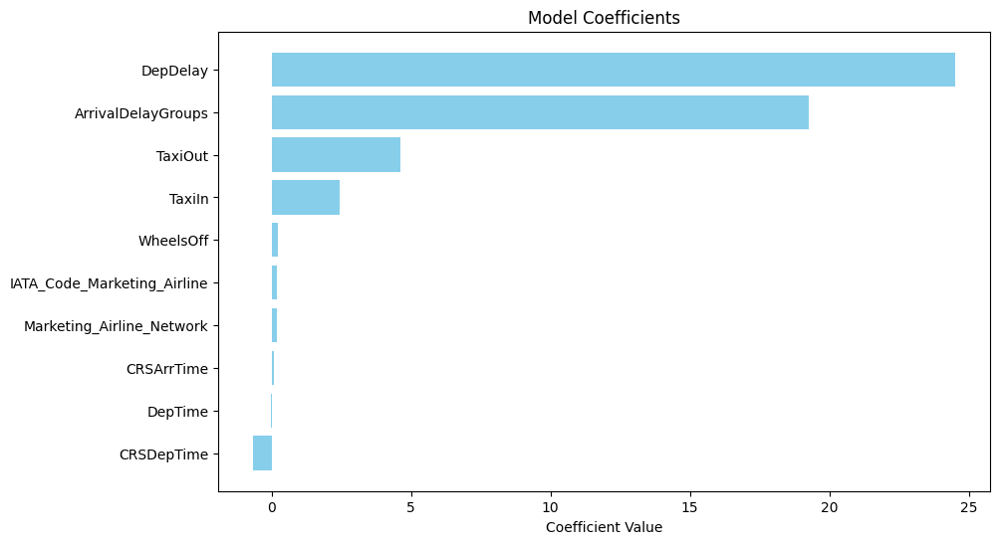

In [ ]:
# Create a bar chart of feature importances(EDA #3)

feature_importance = pd.DataFrame({
    'Feature': X.columns,
    'Coefficient': lr_model.coef_
}).sort_values(by='Coefficient', ascending=True)

plt.figure(figsize=(10, 6))
plt.barh(feature_importance['Feature'], feature_importance['Coefficient'], color='skyblue')
plt.xlabel('Coefficient Value')
plt.title('Model Coefficients')
plt.show()

# Neural Network

### Justification

1.  **Handling Complex Non-linearities:** Neural networks excel at identifying and modeling complex, non-linear interactions between variables, which can be crucial for such a dataframe with many columns.
2.   **Scalability:** Neural networks often perform better as the amount of data increases, making them suitable for large datasets like this one.
3.   **Feature Learning:** Neural networks have the ability to automatically learn the importance and representation of features through the training process.


### Limitations and Potential Biases
1.   **Model Interpretability:** It is difficult to understand exactly how inputs are being transformed into outputs at each layer, which complicates the explanation of model decisions.
2.   **Sensitive to Input Scaling:** Neural networks require careful data preprocessing, such as feature scaling and normalization, to function effectively. They are sensitive to the scale and type of input data.
3.   **Overfitting Risks:** The complexity of neural networks, particularly deep learning models, can lead to overfitting.

In [ ]:
import torch
from torch.utils.data import DataLoader, TensorDataset
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

# Select top 10 features from df (without redundancy)
columns = ['ArrivalDelayGroups', 'DepDelay', 'TaxiOut', 'DepTime', 'WheelsOff', 'TaxiIn', 'CRSDepTime', 'CRSArrTime', 'Marketing_Airline_Network', 'IATA_Code_Marketing_Airline']

# Selecting features and target variable
X = df[columns]
y = np.array(df['ArrDelay'])

# Splitting the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Scaling the features
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# Convert arrays to PyTorch tensors
X_train = torch.tensor(X_train, dtype = torch.float32)
X_test = torch.tensor(X_test, dtype = torch.float32)
y_train = torch.tensor(y_train, dtype = torch.float32).view(-1, 1)
y_test = torch.tensor(y_test, dtype = torch.float32).view(-1, 1)

In [ ]:
# Instantiate and Fit PCA
pca = PCA()
X2 = pca.fit(X_train)

# Save the explained variance ratios into variable called "explained_variance_ratios"
explained_variance_ratios = pca.explained_variance_ratio_

# Save the cumulative explained variance ratios into variable called "cum_evr"
cum_evr = np.cumsum(explained_variance_ratios)

Text(0.5, 1.0, 'Cumulative Explained Variance vs. Number of PCA Components')

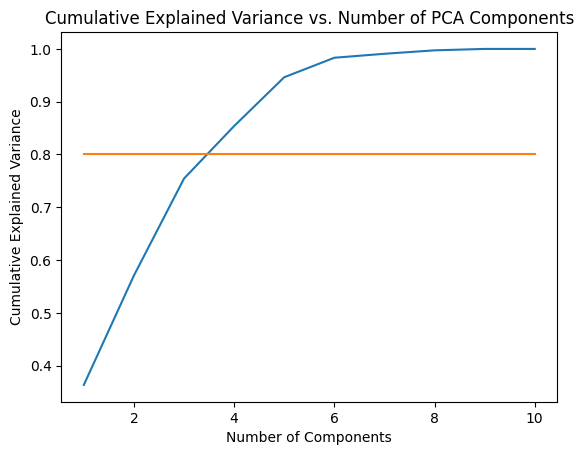

In [ ]:
# Find optimal num components to use (n) by plotting explained variance ratio

x_ticks = np.arange(len(cum_evr)) + 1

plt.plot(size = [8, 6])
sns.lineplot(x = x_ticks, y = cum_evr)
sns.lineplot(x = x_ticks, y = 0.8 * np.ones(len(cum_evr)))
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.title('Cumulative Explained Variance vs. Number of PCA Components')

In [ ]:
# 1. Refit and transform on training with parameter n (as deduced from the last step)
n = 4
pca = PCA(n_components = n)
X_train = torch.tensor(pca.fit_transform(X_train),dtype = torch.float32)

# 2. Transform on Testing Set
X_test = torch.tensor(pca.transform(X_test),dtype = torch.float32)

In [ ]:
# Create DataLoader for batch processing
train_dataset = TensorDataset(X_train, y_train)
train_loader = DataLoader(dataset=train_dataset, batch_size=20, shuffle=True)

In [ ]:
import torch
import torch.nn as nn
from torch.utils.data import DataLoader, TensorDataset
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

class NeuralNet(nn.Module):
    def __init__(self):
        super(NeuralNet, self).__init__()
        self.layer1 = nn.Linear(X_train.shape[1], 128)
        self.relu1 = nn.ReLU()
        self.layer2 = nn.Linear(128, 64)
        self.relu2 = nn.ReLU()
        self.layer3 = nn.Linear(64, 32)
        self.relu3 = nn.ReLU()
        self.layer4 = nn.Linear(32, 16)
        self.relu4 = nn.ReLU()
        self.layer5 = nn.Linear(16, 1)

    def forward(self, x):
        x = self.layer1(x)
        x = self.relu1(x)
        x = self.layer2(x)
        x = self.relu2(x)
        x = self.layer3(x)
        x = self.relu3(x)
        x = self.layer4(x)
        x = self.relu4(x)
        x = self.layer5(x)
        return x

# Initialize the model
model = NeuralNet()


In [ ]:
def custom_accuracy(y_true, y_pred, threshold=5):
    with torch.no_grad():
        accurate = torch.abs(y_true - y_pred) <= threshold
        return torch.mean(accurate.float())

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = model.to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=0.01)
criterion = nn.MSELoss()
trainAccList = []
testAccList = []
# Training the model
num_epochs = 25
for epoch in range(num_epochs):
    model.train()  # Set model to training mode
    for inputs, labels in train_loader:
        inputs, labels = inputs.to(device), labels.to(device)
        # Forward pass
        outputs = model(inputs)
        loss = criterion(outputs, labels)

        # Backward and optimize
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

    # Evaluate the model after each epoch
    model.eval()
    with torch.no_grad():
        predictions = model(X_train)
        train_loss = criterion(predictions, y_train)
        train_acc = custom_accuracy(y_train, predictions,5)

        test_predictions = model(X_test)
        test_loss = criterion(test_predictions, y_test)
        test_acc = custom_accuracy(y_test, test_predictions,5)
    trainAccList.append(train_acc.item())
    testAccList.append(test_acc.item())
    print(f'Epoch [{epoch+1}/{num_epochs}], Train Loss: {train_loss.item():.4f}, Train Acc: {train_acc.item():.4f}, Test Loss: {test_loss.item():.4f}, Test Acc: {test_acc.item():.4f}')

Epoch [1/25], Train Loss: 31.6338, Train Acc: 0.6544, Test Loss: 30.6955, Test Acc: 0.6604
Epoch [2/25], Train Loss: 60.3938, Train Acc: 0.6445, Test Loss: 59.7023, Test Acc: 0.6448
Epoch [3/25], Train Loss: 40.1385, Train Acc: 0.6316, Test Loss: 40.2571, Test Acc: 0.6270
Epoch [4/25], Train Loss: 25.6777, Train Acc: 0.6928, Test Loss: 25.5688, Test Acc: 0.6935
Epoch [5/25], Train Loss: 26.6578, Train Acc: 0.6769, Test Loss: 26.4872, Test Acc: 0.6775
Epoch [6/25], Train Loss: 37.8813, Train Acc: 0.6786, Test Loss: 37.6813, Test Acc: 0.6785
Epoch [7/25], Train Loss: 28.9935, Train Acc: 0.7201, Test Loss: 28.3061, Test Acc: 0.7247
Epoch [8/25], Train Loss: 35.1852, Train Acc: 0.6967, Test Loss: 34.5361, Test Acc: 0.7010
Epoch [9/25], Train Loss: 26.2684, Train Acc: 0.7170, Test Loss: 25.8443, Test Acc: 0.7153
Epoch [10/25], Train Loss: 28.2509, Train Acc: 0.7043, Test Loss: 28.2744, Test Acc: 0.7001
Epoch [11/25], Train Loss: 40.5544, Train Acc: 0.6416, Test Loss: 39.5696, Test Acc: 0.64

In [ ]:
torch.save(model.state_dict(), "/content/drive/Shareddrives/CIS 5450 Project (VPN)/best_neural_network_model")

In [ ]:
loaded_nn = NeuralNet()
loaded_nn.load_state_dict(torch.load("/content/drive/Shareddrives/CIS 5450 Project (VPN)/best_neural_network_model"))

<All keys matched successfully>

# Random Forest

### Justification

1.  **Handling Non-linear Relationships:** Unlike linear regression, random forests can handle complex, non-linear interactions between variables without needing any transformation of the data. This capability makes it suitable for modeling flight delays where relationships might not be linear.
2.   **Robustness to Overfitting:** By building multiple trees and averaging their predictions, random forests reduce the risk of overfitting to the training data, which is a common problem in models like decision trees.
3.   **Feature Importance:** Random forests provide insights into which features are most important for predicting the outcome. This is beneficial when needing to understand the driving factors behind flight delays, such as departure delays, weather conditions, or specific airline issues.


### Limitations and Potential Biases
1.   **Model Interpretability:**  While random forests provide an estimate of feature importance, it is hard to understand the specific decisions within individual trees and how they lead to the final prediction.
2.   **Computationally Expensive:** Training a random forest can be computationally expensive, especially with large datasets and a high number of trees, potentially leading to longer training times.
3.   **Bias Towards Certain Features:** If some features have a wide range of values or more categories, random forests can become biased towards these features, thinking they are more important than they actually are.

In [ ]:
# Select top 10 features from df (without redundancy)
columns = ['ArrivalDelayGroups', 'DepDelay', 'TaxiOut', 'DepTime', 'WheelsOff', 'TaxiIn', 'CRSDepTime', 'CRSArrTime', 'Marketing_Airline_Network', 'IATA_Code_Marketing_Airline']

# Selecting features and target variable
X = df[columns]
y = df['ArrDelay']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Scaling the features
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

In [ ]:
# Instantiate and Fit PCA
pca = PCA()
X2 = pca.fit(X_train)

# Save the explained variance ratios into variable called "explained_variance_ratios"
explained_variance_ratios = pca.explained_variance_ratio_

# Save the cumulative explained variance ratios into variable called "cum_evr"
cum_evr = np.cumsum(explained_variance_ratios)

Text(0.5, 1.0, 'Cumulative Explained Variance vs. Number of PCA Components')

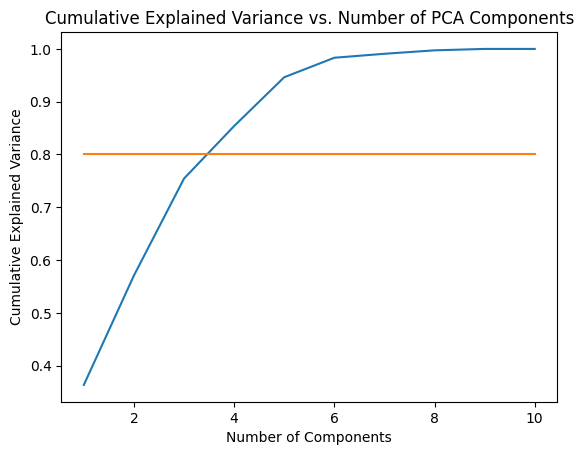

In [ ]:
# Find optimal num components to use (n) by plotting explained variance ratio

x_ticks = np.arange(len(cum_evr)) + 1

plt.plot(size = [8, 6])
sns.lineplot(x = x_ticks, y = cum_evr)
sns.lineplot(x = x_ticks, y = 0.8 * np.ones(len(cum_evr)))
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.title('Cumulative Explained Variance vs. Number of PCA Components')

In [ ]:
# 1. Refit and transform on training with parameter n (as deduced from the last step)
n = 4
pca = PCA(n_components = n)
X_train = pca.fit_transform(X_train)

# 2. Transform on Testing Set and store it as `X_test_pca`
X_test = pca.transform(X_test)

In [ ]:
# Define the model
rf = RandomForestRegressor(random_state=42)

# Create the parameter grid
param_grid = {
    'n_estimators': [10, 50, 100],
    'max_depth': [10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

# Setup the grid search
grid_search = GridSearchCV(estimator=rf, param_grid=param_grid, cv=3, verbose=3, n_jobs=-1)

# Fit the grid search to the data
grid_search.fit(X_train, y_train)

Fitting 3 folds for each of 81 candidates, totalling 243 fits


/usr/local/lib/python3.10/dist-packages/joblib/externals/loky/backend/fork_exec.py:38: RuntimeWarning:

os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.



GridSearchCV(cv=3, estimator=RandomForestRegressor(random_state=42), n_jobs=-1,
             param_grid={'max_depth': [10, 20, 30],
                         'min_samples_leaf': [1, 2, 4],
                         'min_samples_split': [2, 5, 10],
                         'n_estimators': [10, 50, 100]},
             verbose=3)

In [ ]:
# Make predictions with the best model
predictions = grid_search.best_estimator_.predict(X_test)

# Calculate RMSE
rmse = mean_squared_error(y_test, predictions, squared=False)
print(f'Root Mean Squared Error (RMSE) on test data: {rmse:.4f}')

# Optional: Print best model parameters
print("Best model parameters:", grid_search.best_params_)


Root Mean Squared Error (RMSE) on test data: 4.7146
Best model parameters: {'max_depth': 20, 'min_samples_leaf': 2, 'min_samples_split': 10, 'n_estimators': 100}


In [ ]:
def custom_accuracy(y_true, y_pred, threshold=5):
    return np.mean(np.abs(y_true - y_pred) <= threshold)

accuracy = custom_accuracy(y_test, predictions, threshold=5)
print(f'Custom Accuracy (within ±5 mins): {accuracy}')

Custom Accuracy (within ±5 mins): 0.7401891586674195


In [ ]:
from joblib import dump

# Save the best model
dump(grid_search.best_estimator_, '/content/drive/Shareddrives/CIS 5450 Project (VPN)/best_random_forest_model.joblib')

['/content/drive/Shareddrives/CIS 5450 Project (VPN)/best_random_forest_model.joblib']

In [ ]:
from joblib import load

# Load the model from the file
loaded_rf = load('/content/drive/Shareddrives/CIS 5450 Project (VPN)/best_random_forest_model.joblib')

# Results

In [ ]:
# Calculate feature importances
importances = loaded_rf.feature_importances_

In [ ]:
# Create the bar chart
fig = px.bar(x=[columns[i] for i in np.argsort(importances)[::-1]],
             y=sorted(importances, reverse=True),
             labels={'x': 'Features', 'y': 'Importance'},
             title='Feature Importances in Random Forest Model')
fig.show()

In [ ]:
# Assuming 'trainAccList' is a list of training accuracies
epochs = list(range(1, len(trainAccList) + 1))

# Create the figure
fig = go.Figure()

# Add a line trace to the figure
fig.add_trace(go.Scatter(
    x = epochs,
    y = trainAccList,
    mode = 'lines+markers',
    marker = dict(color='blue'),
    line = dict(color='blue')
))

# Set figure layout options
fig.update_layout(
    title = 'Training Accuracy vs. Epochs',
    xaxis_title = 'Epochs',
    yaxis_title = 'Accuracy (%)',
    width=500,
    height=300
)

# Add grid lines for better readability
fig.update_xaxes(showgrid = True, gridwidth = 1, gridcolor = 'lightgrey')
fig.update_yaxes(showgrid = True, gridwidth = 1, gridcolor = 'lightgrey')

# Show the plot
fig.show()

In [ ]:
# Generate predictions for linear regression
lr_predictions = lr_model.predict(X_test)

# Generate predictions for random forest
rf_predictions = loaded_rf.predict(X_test)

# Assuming you've scaled X_train during training, apply the same scaling to X_test
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Convert X_test to a PyTorch tensor
X_test_tensor = torch.tensor(X_test_scaled, dtype=torch.float32)

# If using GPU
if torch.cuda.is_available():
    X_test_tensor = X_test_tensor.to('cuda')
    model = model.to('cuda')

model.eval()

# Get predictions
with torch.no_grad():
    nn_predictions = model(X_test_tensor).view(-1).cpu().numpy()

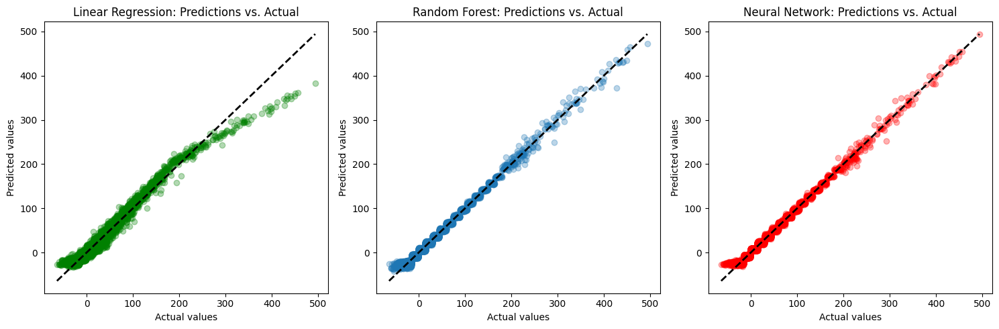

In [ ]:
# Setting up the figure and subplots
plt.figure(figsize=(15, 5))

plt.subplot(1, 3, 1)
plt.scatter(y_test, lr_predictions, alpha=0.3, color='g')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.title('Linear Regression: Predictions vs. Actual')
plt.xlabel('Actual values')
plt.ylabel('Predicted values')

plt.subplot(1, 3, 2)
plt.scatter(y_test, rf_predictions, alpha=0.3)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.title('Random Forest: Predictions vs. Actual')
plt.xlabel('Actual values')
plt.ylabel('Predicted values')

plt.subplot(1, 3, 3)
plt.scatter(y_test, nn_predictions, alpha=0.3, color='r')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.title('Neural Network: Predictions vs. Actual')
plt.xlabel('Actual values')
plt.ylabel('Predicted values')

plt.tight_layout()
plt.show()

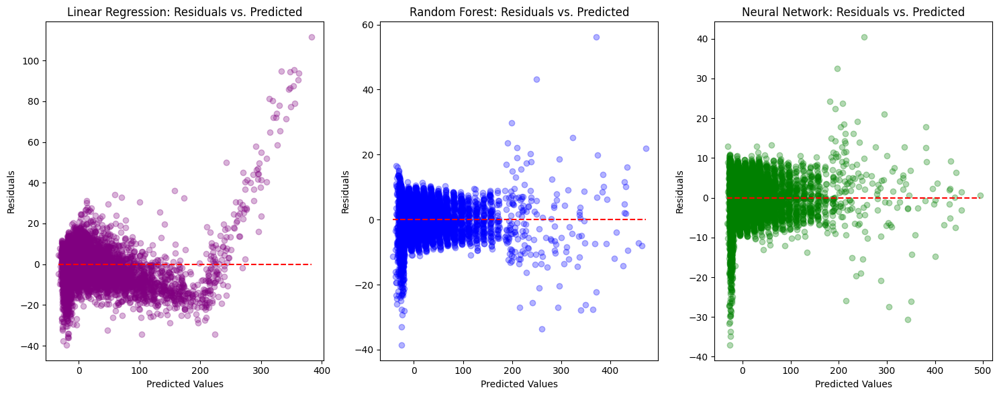

In [ ]:
difference_rf = y_test - rf_predictions
difference_nn = y_test - nn_predictions
difference_lr = y_test - lr_predictions

# Setting up the figure and subplots
plt.figure(figsize=(15, 6))

# Subplot for Linear Regression
plt.subplot(1, 3, 1)
plt.scatter(lr_predictions, difference_lr, alpha=0.3, color='purple')
plt.hlines(y=0, xmin=lr_predictions.min(), xmax=lr_predictions.max(), colors='red', linestyles='--')
plt.xlabel('Predicted Values')
plt.ylabel('Residuals')
plt.title('Linear Regression: Residuals vs. Predicted')

# Subplot for Random Forest
plt.subplot(1, 3, 2)
plt.scatter(rf_predictions, difference_rf, alpha=0.3, color='blue')
plt.hlines(y=0, xmin=rf_predictions.min(), xmax=rf_predictions.max(), colors='red', linestyles='--')
plt.xlabel('Predicted Values')
plt.ylabel('Residuals')
plt.title('Random Forest: Residuals vs. Predicted')

# Subplot for Neural Network
plt.subplot(1, 3, 3)
plt.scatter(nn_predictions, difference_nn, alpha=0.3, color='green')
plt.hlines(y=0, xmin=nn_predictions.min(), xmax=nn_predictions.max(), colors='red', linestyles='--')
plt.xlabel('Predicted Values')
plt.ylabel('Residuals')
plt.title('Neural Network: Residuals vs. Predicted')

plt.tight_layout()
plt.show()

In [ ]:
# Assuming you have `rf_predictions` and `nn_predictions` available
mse_lr = mean_squared_error(y_test, lr_predictions)
mse_rf = mean_squared_error(y_test, rf_predictions)
mse_nn = mean_squared_error(y_test, nn_predictions)

rmse_lr = np.sqrt(mse_lr)
rmse_rf = np.sqrt(mse_rf)
rmse_nn = np.sqrt(mse_nn)

r2_lr = r2_score(y_test, lr_predictions)
r2_rf = r2_score(y_test, rf_predictions)
r2_nn = r2_score(y_test, nn_predictions)

In [ ]:
fig = go.Figure(data=[
    go.Bar(name='Linear Regression', x=['MSE', 'RMSE', 'R²'], y=[mse_lr, rmse_lr, r2_lr]),
    go.Bar(name='Random Forest', x=['MSE', 'RMSE', 'R²'], y=[mse_rf, rmse_rf, r2_rf]),
    go.Bar(name='Neural Network', x=['MSE', 'RMSE', 'R²'], y=[mse_nn, rmse_nn, r2_nn])
])

# Change the bar mode and update the layout
fig.update_layout(
    barmode='group',
    title='Comparison of Regression Metrics Across Models',
    xaxis_title='Metric',
    yaxis_title='Value',
    legend_title='Model'
)

# Show the figure
fig.show()

# Conclusion and Discussion

### Interpretability

Linear Regression Model:

Interpretable: This model is considered highly interpretable because it uses straightforward mathematical expressions to describe the relationships between variables. The coefficients in a linear regression indicate the expected change in the dependent variable for a one-unit change in an independent variable, assuming all other variables are held constant. This makes it easy to understand and explain how each feature affects the prediction.

Random Forest Model:

Less Interpretable: While each individual decision tree in a random forest is interpretable, the overall model becomes less so because it consists of many trees and aggregates their predictions. This ensemble approach enhances predictive accuracy and robustness but reduces transparency, as it is more difficult to trace how input features are transformed into outputs through numerous decision paths. However, random forests do provide feature importance scores, which can offer some insights into which variables are most influential in predicting the outcome.

Neural Network Model:

Not Interpretable: Neural networks, particularly deep learning models, are known for their complexity and layered structure, which allows them to model highly nonlinear relationships. However, this complexity makes them less interpretable, as the interactions between layers and the multitude of parameters involved make it challenging to discern how decisions are made. This "black box" nature is a significant drawback in scenarios where transparency is crucial.


### Challenges/Limitations

Personal Challenges
*   Difficult to merge results when working synchronously
*   Frequently ran out of RAM because of the size of the dataset
*   Long training times (ex. 25 minutes for to train random forest)

Limitations of Data:
*   Data Collection Biases: Biases can occur based on how data is collected. For example, if flight delay data is predominantly from major airports or specific airlines, it may not generalize well to smaller airports or other airlines.
*   Historical Bias: Historical data used to train the model might embed past operational inefficiencies that may not be present anymore.
prioritization of certain flights over others).


### Future Work

The model with the highest accuracy and the lowest RMSE is the Random Forest. In the future, we can use this information to train better models to predict flight delays by using better tuned Random Forest models. We could potentially use Neural Networks with different shapes because the NN accuracy wasn’t much lower either. In fact, from this data we can see that any model that isn’t linear could potentially be a good option.

We could also collect more data in the future about features we didn’t have right now, like ticket demand or some external weather factors to get a better idea of the extent to which these direct factors impact arrival delays

In [ ]:
# install necessary packages
# REF for packages: https://stackoverflow.com/questions/52588552/google-co-laboratory-notebook-pdf-download
# REF hide code cell outputs: https://stackoverflow.com/questions/58457261/can-you-hide-code-cell-outputs-in-google-colab
!apt-get install texlive texlive-xetex texlive-latex-extra pandoc &> /dev/null
!pip install pypandoc &> /dev/null

In [ ]:
# get the file name of the current notebook
from requests import get
from socket import gethostname, gethostbyname
from urllib.parse import unquote
ip = gethostbyname(gethostname()) # e.g. 172.28.0.12
filename = unquote(get(f"http://{ip}:9000/api/sessions").json()[0]["name"])

In [ ]:
# copy the notebook file to the workspace (see the folder icon on the left)

# TODO: Replace with the path of your homework notebook file
!cp "/content/drive/Shareddrives/CIS 5450 Project (VPN)/$filename" ./

# convert the notebook to PDF
# => the PDF will be in the workspace
# ==> PLEASE DOWNLOAD FROM THERE
!jupyter nbconvert --to PDF "$filename"

[NbConvertApp] Converting notebook CIS 5450 Final Project.ipynb to PDF
/usr/local/lib/python3.10/dist-packages/nbconvert/filters/datatypefilter.py:41: UserWarning: Your element with mimetype(s) dict_keys(['text/html']) is not able to be represented.
  warn(
/usr/local/lib/python3.10/dist-packages/nbconvert/filters/datatypefilter.py:41: UserWarning: Your element with mimetype(s) dict_keys(['text/html']) is not able to be represented.
  warn(
[NbConvertApp] Support files will be in CIS 5450 Final Project_files/
[NbConvertApp] Making directory ./CIS 5450 Final Project_files
[NbConvertApp] Making directory ./CIS 5450 Final Project_files
[NbConvertApp] Making directory ./CIS 5450 Final Project_files
[NbConvertApp] Making directory ./CIS 5450 Final Project_files
[NbConvertApp] Making directory ./CIS 5450 Final Project_files
[NbConvertApp] Making directory ./CIS 5450 Final Project_files
[NbConvertApp] Making directory ./CIS 5450 Final Project_files
[NbConvertApp] Making directory ./CIS 5450 F